In [2]:
from astropy.io import fits
import astropy.units as u
import matplotlib.pyplot as plt
from reproject import reproject_interp
from astropy.wcs import WCS
from matplotlib.colors import LinearSegmentedColormap
from astropy.visualization import simple_norm
import numpy as np
from matplotlib.patches import Rectangle
from regions import Regions
from astropy.nddata import Cutout2D

filter_subtraction_path = '/orange/adamginsburg/jwst/w51/filter_subtractions'
f335_f2100_ratio = fits.open(f'{filter_subtraction_path}/f335_f2100_ratio.fits')[0]
f405_minus_f410 = fits.open(f'{filter_subtraction_path}/f405n_minus_f410m.fits')[0]
f480_minus_f360 = fits.open(f'{filter_subtraction_path}/f480m_minus_f360m_unscaled.fits')[0]
f335_f480_ratio = fits.open(f'{filter_subtraction_path}/f335_f480_ratio.fits')[0]



Set OBSGEO-B to   -25.254571 from OBSGEO-[XYZ].
Set OBSGEO-H to 1611129611.449 from OBSGEO-[XYZ]'. [astropy.wcs.wcs]


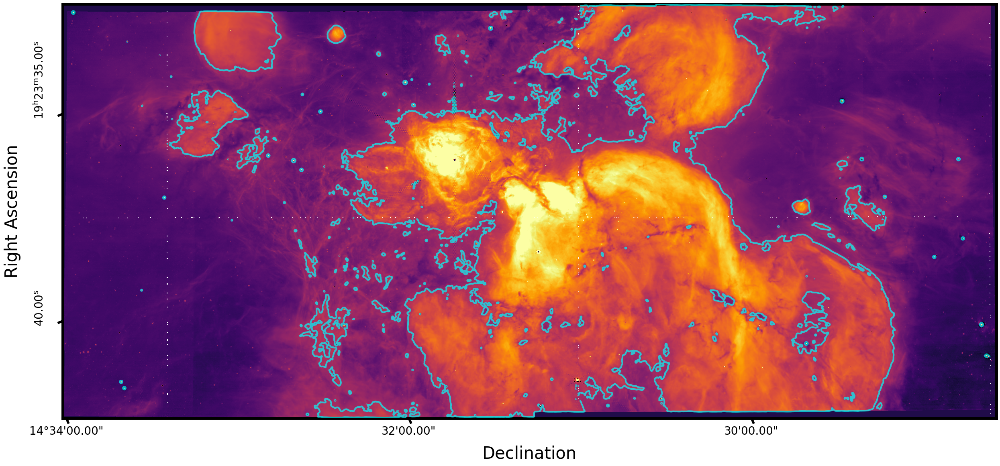

In [3]:
import matplotlib as mpl
import scipy.ndimage

plt.rcParams['axes.labelsize']=20
plt.rcParams['xtick.labelsize']=20
plt.rcParams['ytick.labelsize']=20
plt.rcParams['axes.titlesize']=20
mpl.rcParams['axes.linewidth'] = 5
mpl.rcParams['xtick.major.size'] = 10
mpl.rcParams['xtick.major.width'] = 4
mpl.rcParams['xtick.minor.size'] = 5
mpl.rcParams['xtick.minor.width'] = 2
mpl.rcParams['ytick.major.size'] = 10
mpl.rcParams['ytick.major.width'] = 4
mpl.rcParams['ytick.minor.size'] = 5
mpl.rcParams['ytick.minor.width'] = 2

fig = plt.figure(figsize=(30,14))
ax1 = fig.add_subplot(111, projection=WCS(f405_minus_f410.header, naxis=2))
norm = simple_norm(f405_minus_f410.data, 'log', vmin=-1.753765709595882, vmax=1262.3004659619687)
ax1.imshow(f405_minus_f410.data, norm=norm, cmap='inferno', origin='lower')
f405_f410_level = [25]
smoothed_f405_minus_f410 = scipy.ndimage.gaussian_filter(f405_minus_f410.data, 3)
ax1.contour(smoothed_f405_minus_f410, levels=f405_f410_level, colors='cyan', linewidths=3, alpha=0.7)
ra = lon = ax1.coords['ra']
dec = lat = ax1.coords['dec']
ra.set_major_formatter('hh:mm:ss.ss')
dec.set_major_formatter('dd:mm:ss.ss')
ra.set_axislabel('Right Ascension', fontsize=30)
ra.set_ticklabel(rotation=90, pad=20)
dec.set_axislabel('Declination', fontsize=30)

ra.set_ticks_position('l')
ra.set_ticklabel_position('l')
ra.set_axislabel_position('l')
dec.set_ticks_position('b')
dec.set_ticklabel_position('b')
dec.set_axislabel_position('b')

Set OBSGEO-B to   -25.271881 from OBSGEO-[XYZ].
Set OBSGEO-H to 1611441536.798 from OBSGEO-[XYZ]'. [astropy.wcs.wcs]


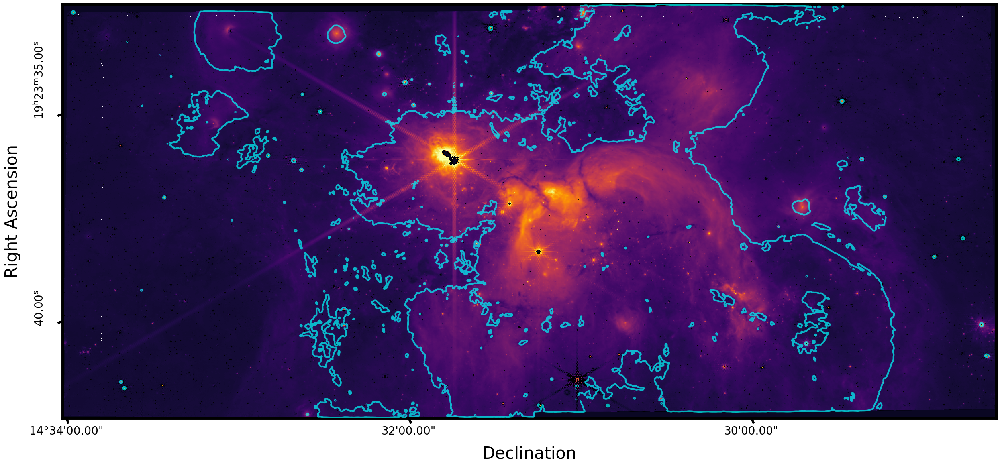

In [4]:
fig = plt.figure(figsize=(30,14))
ax1 = fig.add_subplot(111, projection=WCS(f480_minus_f360.header, naxis=2))
norm = simple_norm(f480_minus_f360.data, 'log', vmin=-2.096357027662634, vmax=3682.3342748055093)
ax1.imshow(f480_minus_f360.data, norm=norm, cmap='inferno', origin='lower')
ax1.contour(smoothed_f405_minus_f410, levels=f405_f410_level, colors='cyan', linewidths=3, alpha=0.7)
ra = lon = ax1.coords['ra']
dec = lat = ax1.coords['dec']
ra.set_major_formatter('hh:mm:ss.ss')
dec.set_major_formatter('dd:mm:ss.ss')
ra.set_axislabel('Right Ascension', fontsize=30)
ra.set_ticklabel(rotation=90, pad=20)
dec.set_axislabel('Declination', fontsize=30)

ra.set_ticks_position('l')
ra.set_ticklabel_position('l')
ra.set_axislabel_position('l')
dec.set_ticks_position('b')
dec.set_ticklabel_position('b')
dec.set_axislabel_position('b')

Set OBSGEO-B to   -25.271881 from OBSGEO-[XYZ].
Set OBSGEO-H to 1611441536.798 from OBSGEO-[XYZ]'. [astropy.wcs.wcs]


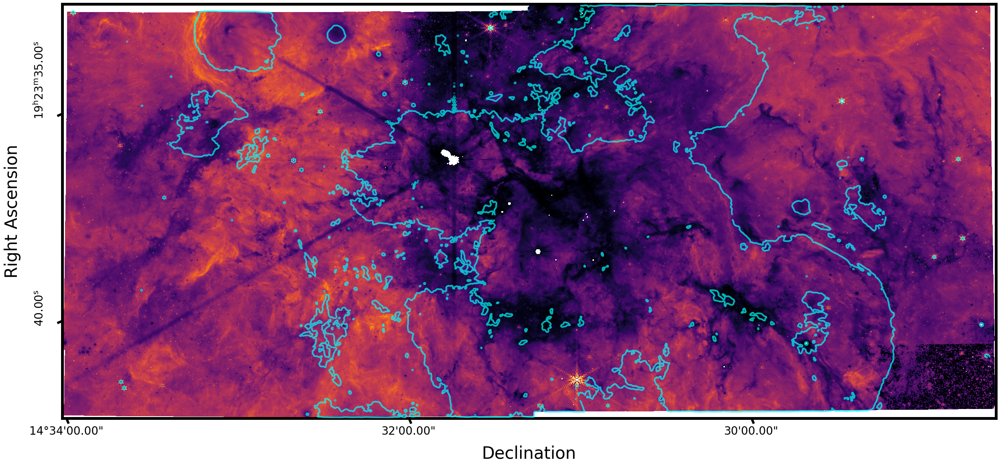

In [5]:

fig = plt.figure(figsize=(30,14))
ax1 = fig.add_subplot(111, projection=WCS(f335_f480_ratio.header, naxis=2))
ax1.imshow(f335_f480_ratio.data, vmin=0.07348218424550346, vmax=2.5360416918992996, cmap='inferno', origin='lower')
ax1.contour(smoothed_f405_minus_f410, levels=f405_f410_level, colors='cyan', linewidths=3, alpha=0.7)

ra = lon = ax1.coords['ra']
dec = lat = ax1.coords['dec']
ra.set_major_formatter('hh:mm:ss.ss')
dec.set_major_formatter('dd:mm:ss.ss')
ra.set_axislabel('Right Ascension', fontsize=30)
ra.set_ticklabel(rotation=90, pad=20)
dec.set_axislabel('Declination', fontsize=30)

ra.set_ticks_position('l')
ra.set_ticklabel_position('l')
ra.set_axislabel_position('l')
dec.set_ticks_position('b')
dec.set_ticklabel_position('b')
dec.set_axislabel_position('b')

Set OBSGEO-B to   -25.254571 from OBSGEO-[XYZ].
Set OBSGEO-H to 1611129611.449 from OBSGEO-[XYZ]'. [astropy.wcs.wcs]
Set OBSGEO-B to   -25.271881 from OBSGEO-[XYZ].
Set OBSGEO-H to 1611441536.798 from OBSGEO-[XYZ]'. [astropy.wcs.wcs]


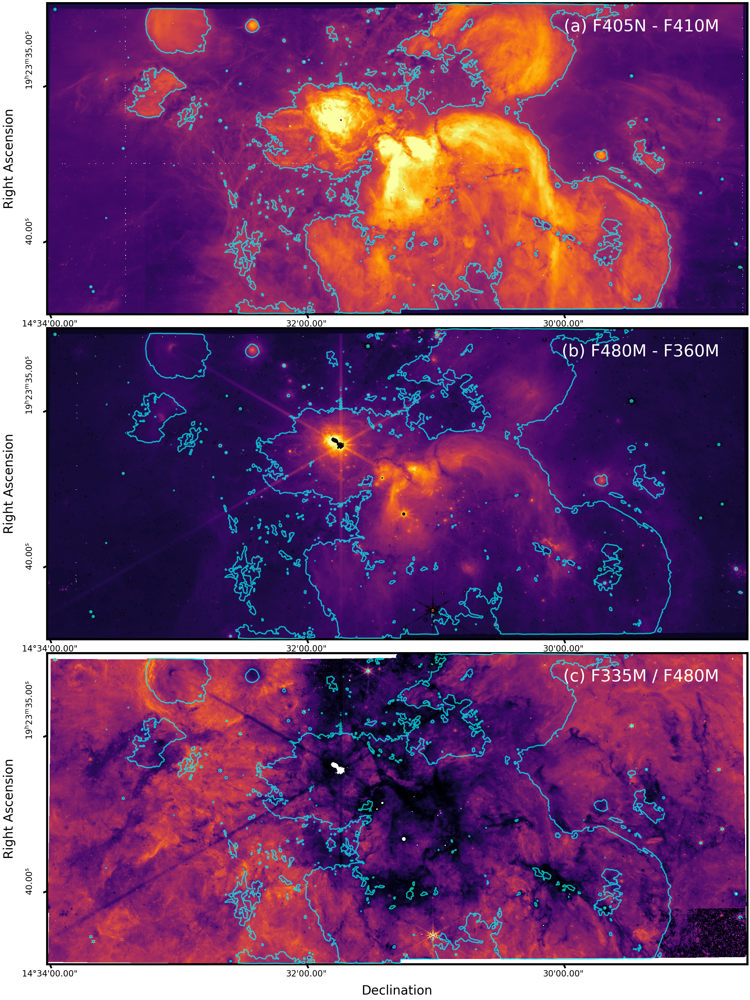

In [20]:
fig = plt.figure(figsize=(30,42))
gs = fig.add_gridspec(3, 1, hspace=0.0, wspace=0.0)
ax1 = fig.add_subplot(gs[0, 0], projection=WCS(f405_minus_f410.header, naxis=2))
ax2 = fig.add_subplot(gs[1, 0], projection=WCS(f480_minus_f360.header, naxis=2))
ax3 = fig.add_subplot(gs[2, 0], projection=WCS(f335_f480_ratio.header, naxis=2))

norm = simple_norm(f405_minus_f410.data, 'log', vmin=-1.753765709595882, vmax=1262.3004659619687)
ax1.imshow(f405_minus_f410.data, norm=norm, cmap='inferno', origin='lower')
f405_f410_level = [25]
smoothed_f405_minus_f410 = scipy.ndimage.gaussian_filter(f405_minus_f410.data, 3)
ax1.contour(smoothed_f405_minus_f410, levels=f405_f410_level, colors='cyan', linewidths=3, alpha=0.7)
ra = lon = ax1.coords['ra']
dec = lat = ax1.coords['dec']

ra.set_major_formatter('hh:mm:ss.ss')
dec.set_major_formatter('dd:mm:ss.ss')
ra.set_axislabel('Right Ascension', fontsize=30)
ra.set_ticklabel(rotation=90, pad=20)

ra.set_ticks_position('l')
ra.set_ticklabel_position('l')
ra.set_axislabel_position('l')
dec.set_ticks_position('b')
dec.set_ticklabel_position('b')
dec.set_axislabel_position('b')
ax1.set_xlabel('')

norm = simple_norm(f480_minus_f360.data, 'log', vmin=-2.096357027662634, vmax=3682.3342748055093)
ax2.imshow(f480_minus_f360.data, norm=norm, cmap='inferno', origin='lower')
ax2.contour(smoothed_f405_minus_f410, levels=f405_f410_level, colors='cyan', linewidths=3, alpha=0.7)
ra = lon = ax2.coords['ra']
dec = lat = ax2.coords['dec']
ra.set_major_formatter('hh:mm:ss.ss')
dec.set_major_formatter('dd:mm:ss.ss')
ra.set_axislabel('Right Ascension', fontsize=30)
ra.set_ticklabel(rotation=90, pad=20)

ra.set_ticks_position('l')
ra.set_ticklabel_position('l')
ra.set_axislabel_position('l')
dec.set_ticks_position('b')
dec.set_ticklabel_position('b')
dec.set_axislabel_position('b')
ax2.set_xlabel('')
ax3.imshow(f335_f480_ratio.data, vmin=0.07348218424550346, vmax=2.5360416918992996, cmap='inferno', origin='lower')
ax3.contour(smoothed_f405_minus_f410, levels=f405_f410_level, colors='cyan', linewidths=3, alpha=0.7)

ra = lon = ax3.coords['ra']
dec = lat = ax3.coords['dec']
ra.set_major_formatter('hh:mm:ss.ss')
dec.set_major_formatter('dd:mm:ss.ss')
ra.set_axislabel('Right Ascension', fontsize=30)
ra.set_ticklabel(rotation=90, pad=20)
dec.set_axislabel('Declination', fontsize=30)

ra.set_ticks_position('l')
ra.set_ticklabel_position('l')
ra.set_axislabel_position('l')
dec.set_ticks_position('b')
dec.set_ticklabel_position('b')
dec.set_axislabel_position('b')
ax1.set_yticks([])
ax2.set_yticks([])
ax1.set_xticklabels([])
ax2.set_xticklabels([])

ax1.text(0.96,0.95, '(a) F405N - F410M', color='white', fontsize=40, transform=ax1.transAxes, ha='right', va='top',)
ax2.text(0.96,0.95, '(b) F480M - F360M', color='white', fontsize=40, transform=ax2.transAxes, ha='right', va='top',)
ax3.text(0.96,0.95, '(c) F335M / F480M', color='white', fontsize=40, transform=ax3.transAxes, ha='right', va='top',)
plt.savefig('plots/multiple_view.png', bbox_inches='tight')